In [1]:
# import neccessary packages
import pandas as pd
import seaborn as sns
import numpy as np
from scipy import stats
import plotly.plotly as py
import plotly.figure_factory as ff

import numpy as np

import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly import tools
import seaborn as sns
import matplotlib.pyplot as plt

# enable plotly for google_colab
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))
pyo.init_notebook_mode(connected=True)

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import classification_report, confusion_matrix,roc_auc_score,average_precision_score,accuracy_score
from sklearn.model_selection import ParameterGrid, GridSearchCV
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from imblearn.under_sampling import RandomUnderSampler


In [2]:
# load data
customers_df = pd.read_csv("https://raw.githubusercontent.com/Thinkful-Ed/data-201-resources/master/customers_data.csv", index_col=0)
customers_df.head()

,purch_amt,gender,card_on_file,age,days_since_last_purch,loyalty
0,19.58,male,no,31.0,35.0,False
1,65.16,male,yes,23.0,61.0,False
2,40.60,female,no,36.0,49.0,False
3,38.01,male,yes,47.0,57.0,False
4,22.32,female,yes,5.0,39.0,False


In [3]:
# count nulls
customers_df.isnull().sum()

purch_amt                0
gender                   0
card_on_file             0
age                      0
days_since_last_purch    0
loyalty                  0
dtype: int64

In [4]:
# categorical variable: gender
print(customers_df.gender.value_counts())

male      60181
female    59819
Name: gender, dtype: int64


In [5]:
# categorical variable card_on_file
print(customers_df.card_on_file.value_counts())

yes    60087
no     59913
Name: card_on_file, dtype: int64


In [0]:
# encode categorical features
customers_df["gender"] = np.where(customers_df.gender == "male", 0.0, 1.0)
customers_df["card_on_file"] = np.where(customers_df.card_on_file == "no", 0.0, 1.0)

In [7]:
customers_df.head()

,purch_amt,gender,card_on_file,age,days_since_last_purch,loyalty
0,19.58,0.0,0.0,31.0,35.0,False
1,65.16,0.0,1.0,23.0,61.0,False
2,40.60,1.0,0.0,36.0,49.0,False
3,38.01,0.0,1.0,47.0,57.0,False
4,22.32,1.0,1.0,5.0,39.0,False


In [8]:
# view continous attributes
customers_df[["purch_amt", "age", "days_since_last_purch"]].describe()

,purch_amt,age,days_since_last_purch
count,120000.000000,120000.000000,120000.000000
mean,44.036234,25.803008,56.605908
std,20.473148,10.153072,16.422187
min,-43.950000,-22.000000,-9.000000
25%,30.210000,19.000000,45.000000
50%,43.970000,26.000000,57.000000
75%,57.830000,33.000000,68.000000
max,142.200000,71.000000,125.000000


In [9]:
# see outliers
configure_plotly_browser_state()
b1 = go.Box(y=customers_df["purch_amt"], name="purch_amt")
b2 = go.Box(y=customers_df["age"], name="age")
b3 = go.Box(y=customers_df["days_since_last_purch"], name="days_since_last_purch")

pyo.iplot([b1,b2,b3])

In [10]:
# see the length of dataframe
# if number of outliers are less than 1% of the data remove them
len(customers_df)

120000

In [0]:
# only continous attributes
cont_df = customers_df[["purch_amt", 	"age",	"days_since_last_purch"]]
# create boolean index. Shows true if a record is an outlier else false
non_outliers = (np.abs(stats.zscore(cont_df)) < 3).all(axis=1)
# remove outliers
customers_df_clean = customers_df[non_outliers]
# remove negatives
cont_df_c = customers_df_clean[["purch_amt", 	"age",	"days_since_last_purch"]]
# create boolean index: True if positive else False
non_negatives = (cont_df_c > 0).all(axis=1)
customers_df_clean = customers_df_clean[non_negatives]

In [12]:
# see outliers now
configure_plotly_browser_state()
b1 = go.Box(y=customers_df_clean["purch_amt"], name="purch_amt")
b2 = go.Box(y=customers_df_clean["age"], name="age")
b3 = go.Box(y=customers_df_clean["days_since_last_purch"], name="days_since_last_purch")

pyo.iplot([b1,b2,b3])

In [46]:
len(customers_df_clean)

116834

In [13]:
np.round((116834 * 100)/120000,2)

97.36

In [16]:
# see distribution of age
configure_plotly_browser_state()
hist_data = [customers_df_clean.age]
group_labels = ['age']
fig = ff.create_distplot(hist_data, group_labels)
pyo.iplot(fig, filename='Basic Distplot')

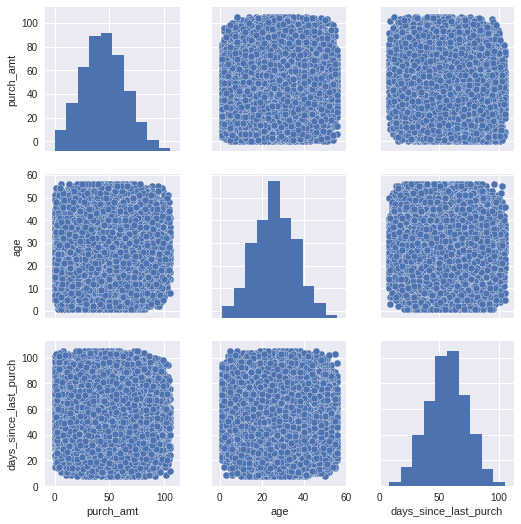

In [17]:
sns.pairplot(customers_df_clean[["purch_amt", 	"age",	"days_since_last_purch"]])
sns.despine()

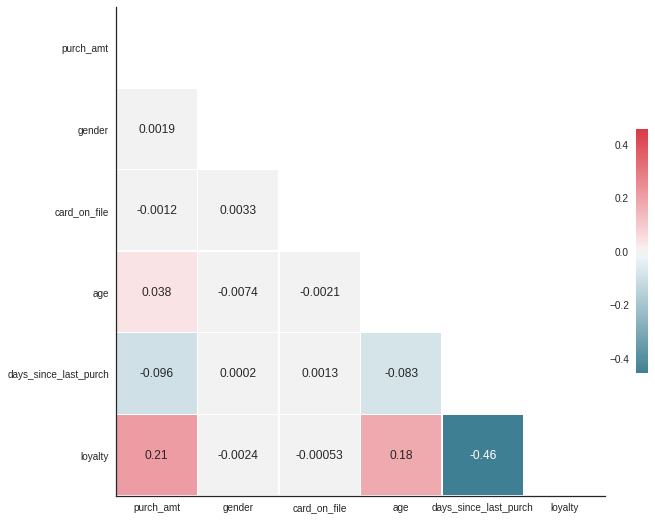

In [18]:
# view correlations

# Code from https://seaborn.pydata.org/examples/many_pairwise_correlations.html
sns.set(style="white")

# Compute the correlation matrix
corr = customers_df_clean.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, annot=True, mask=mask, cmap=cmap, vmax=.4, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
sns.despine()

In [19]:
# check class imbalance
configure_plotly_browser_state()
loy_value_counts = customers_df_clean.loyalty.value_counts()
data = [go.Bar(
            x=loy_value_counts.index,
            y=loy_value_counts.values
    )]

pyo.iplot(data, filename='basic-bar')

In [0]:
# convert loyalty to int
customers_df_clean["loyalty"] = customers_df_clean.loyalty.astype("float64")

In [21]:
# check datatypes 
customers_df_clean.dtypes

purch_amt                float64
gender                   float64
card_on_file             float64
age                      float64
days_since_last_purch    float64
loyalty                  float64
dtype: object

In [22]:
# view data
customers_df_clean.head()

,purch_amt,gender,card_on_file,age,days_since_last_purch,loyalty
0,19.58,0.0,0.0,31.0,35.0,0.0
1,65.16,0.0,1.0,23.0,61.0,0.0
2,40.60,1.0,0.0,36.0,49.0,0.0
3,38.01,0.0,1.0,47.0,57.0,0.0
4,22.32,1.0,1.0,5.0,39.0,0.0


In [23]:
# class imbalance
customers_df.loyalty.value_counts()

False    100000
True      20000
Name: loyalty, dtype: int64

In [0]:
# split the data into two

# independent variables
X = customers_df_clean.drop("loyalty", axis=1)
# dependent variable
y = customers_df_clean.loyalty
X_train, X_test, y_train, y_test = train_test_split(X, y,  test_size=0.2)

In [0]:
# balance classes by undersampling only the train-set
# The test-set should not be undersampled.

rus = RandomUnderSampler()

X_train_u, y_train_u = rus.fit_resample(X_train, y_train)

In [26]:
# try logistic regression model

model_one = LogisticRegression(random_state=0, solver='lbfgs').fit(X_train_u, y_train_u)
model_one.score(X_test, y_test)

0.7858946377369795

In [27]:
# grid search to find the best penality
pipeline_one = make_pipeline(StandardScaler(), LogisticRegression())

param_grid = {'logisticregression__C': [0.001, 0.01, 0.1, 1, 2], 
                   'logisticregression__penalty' :['l2'],
              'logisticregression__solver' : ["lbfgs"]
             }
logistic_search = GridSearchCV(pipeline_one, param_grid, iid=False, cv=5,
                      return_train_score=True, n_jobs=-1)
logistic_search.fit(X_train_u, y_train_u)
print(f"Best parameter {logistic_search.best_params_} \n (CV score=%0.3f): {logistic_search.best_score_}")

Best parameter {'logisticregression__C': 0.1, 'logisticregression__penalty': 'l2', 'logisticregression__solver': 'lbfgs'} 
 (CV score=%0.3f): 0.7947145362215442


In [0]:
scaler = StandardScaler()
# fit on train and tranform train
X_train_rescaled = pd.DataFrame(scaler.fit_transform(X_train_u), columns=X_train.columns)
# transform test
X_test_rescaled = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns)

In [29]:
X_train_rescaled.head()

,purch_amt,gender,card_on_file,age,days_since_last_purch
0,-0.883552,1.012467,-1.000127,-1.247547,1.491709
1,-1.315560,-0.987686,-1.000127,0.557218,1.491709
2,0.979953,1.012467,0.999873,0.256424,1.194918
3,-0.401870,1.012467,-1.000127,0.156159,1.016843
4,-0.442010,1.012467,-1.000127,0.657483,0.304544


In [25]:
X_test_rescaled.head()

,purch_amt,gender,card_on_file,age,days_since_last_purch
0,-0.521037,-0.994537,1.006070,0.548625,-1.116480
1,-0.060574,-0.994537,-0.993967,-0.151417,-0.762739
2,-1.669423,1.005493,1.006070,1.248667,-1.057524
3,0.127041,-0.994537,1.006070,-0.451435,0.652224
4,2.106077,1.005493,1.006070,-1.651507,-0.703783


In [30]:
# grid search to find the best penality after rescaling
pipeline_two = make_pipeline(StandardScaler(), LogisticRegression())

param_grid = {'logisticregression__C': [0.001, 0.01, 0.1, 1, 2], 
                   'logisticregression__penalty' :['l2'],
              'logisticregression__solver' : ["lbfgs"]
             }
logistic_search = GridSearchCV(pipeline_one, param_grid, iid=False, cv=5,
                      return_train_score=True, n_jobs=-1)
logistic_search.fit(X_train_rescaled, y_train_u)
print(f"Best parameter {logistic_search.best_params_} \n (CV score=%0.3f): {logistic_search.best_score_}")

Best parameter {'logisticregression__C': 0.1, 'logisticregression__penalty': 'l2', 'logisticregression__solver': 'lbfgs'} 
 (CV score=%0.3f): 0.7947145362215442


In [31]:
# test model
# create the model again this time using the best parameters
model_two = LogisticRegression(random_state=0, solver='lbfgs', C=0.001, penalty='l2')
model_two.fit(X_train_rescaled, y_train_u)

y_pred = model_two.predict(X_test_rescaled)
y_pred_train = model_two.predict(X_train_rescaled)

print('\n Confusion Matrix')
print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted']))
print(classification_report(y_test, y_pred))
print("ROC-AUC", roc_auc_score(y_test, y_pred))
print("PR-AUC-Score", average_precision_score(y_test, y_pred))
print("Test Accuracy: ", accuracy_score(y_test, y_pred))
print("Train Accuracy: ", accuracy_score(y_train_u, y_pred_train))


 Confusion Matrix
Predicted    0.0   1.0
True                  
0.0        15237  4279
1.0          771  3080
              precision    recall  f1-score   support

         0.0       0.95      0.78      0.86     19516
         1.0       0.42      0.80      0.55      3851

   micro avg       0.78      0.78      0.78     23367
   macro avg       0.69      0.79      0.70     23367
weighted avg       0.86      0.78      0.81     23367

ROC-AUC 0.7902681333346179
PR-AUC-Score 0.3677364056005997
Test Accuracy:  0.7838832541618522
Train Accuracy:  0.7951267551941038


In [32]:
# rank features by positive or negative
feature_mapping = {i:customers_df_clean.columns[i] for i in range(5)}

print("Most positive cofficeints\n(contribute to loyalty postively)")
print()
sorted_features = pd.Series(np.argsort(model_one.coef_).ravel()[::-1])
print(sorted_features.replace(feature_mapping).values)
print()
print("\nMost negative cofficeints\n(contribute to loyalty negatively)")
print()
sorted_features = pd.Series(np.argsort(model_one.coef_).ravel())
print(sorted_features.replace(feature_mapping).values)


Most positive cofficeints
(contribute to loyalty postively)

['age' 'purch_amt' 'card_on_file' 'gender' 'days_since_last_purch']


Most negative cofficeints
(contribute to loyalty negatively)

['days_since_last_purch' 'gender' 'card_on_file' 'purch_amt' 'age']


In [33]:
# XBoost
model_two = XGBClassifier()
model_two.fit(X_train_rescaled, y_train_u)

model_two.predict(X_test)
y_pred_train = model_two.predict(X_train_rescaled)
print('\n Confusion Matrix')
print(pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted']))
print("Test Accuracy: ", accuracy_score(y_test, y_pred))
print("Train Accuracy: ", accuracy_score(y_train_u, y_pred_train))


 Confusion Matrix
Predicted    0.0   1.0
True                  
0.0        15237  4279
1.0          771  3080
Test Accuracy:  0.7838832541618522
Train Accuracy:  0.7972869940911113


In [34]:
fi = pd.DataFrame(columns=["feature", "importance"])
fi["feature"] = X_train.columns
fi["importance"] = model_two.feature_importances_
fi.sort_values(by="importance", ascending=True, inplace=True)
fi

,feature,importance
1,gender,0.005821
2,card_on_file,0.012266
3,age,0.102913
0,purch_amt,0.109787
4,days_since_last_purch,0.769213


In [35]:
configure_plotly_browser_state()



data = [go.Bar(
            y = fi.feature.values,
            x = fi.importance.values,
    orientation = "h"
    )]
layout = go.Layout(
    autosize=False,
    width=800,
    height=500,
    margin=go.layout.Margin(
        l=150,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
    plot_bgcolor='#c7c7c7'
)
fig = go.Figure(data=data, layout=layout)

pyo.iplot(fig, filename='basic-bar')